###### task 1), you may want to analyze the histogram of gray levels in constant areas of the image and infer the type of noise. Please, motivate your intuitions and estimate the noise parameters.

In [1]:
#import libraries
import os
import numpy as np
import cv2
from tqdm import tqdm
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from scipy.stats import spearmanr
from skimage import img_as_float, img_as_ubyte
from skimage.restoration import denoise_wavelet, estimate_sigma
from sklearn.metrics import mean_squared_error
import math

In [2]:
# This function custom_sort_noisy is used to sort a list of filenames
def custom_sort_noisy(file_name):
    prefix = 'R'
    if file_name.startswith(prefix):
        return int(file_name[len(prefix):-4])
    else:
        return float('inf')

In [3]:
#list of images noisy
image_list_noisy = []
img_dir = "C:/Users/ksevi/OneDrive/Desktop/MASTER/SCENE_LALIGANT/decimo_ SICILIA/gr1/Noisy/"
filenames = os.listdir(img_dir)
filenames = sorted(filenames, key=custom_sort_noisy)

In [4]:
for img in tqdm(filenames):
    if img.lower().endswith(('.bmp', '.jpg')):
        img_path = os.path.join(img_dir, img)
        image_list_noisy.append(img_path)

100%|██████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<?, ?it/s]


In [5]:
# This function custom_sort_original is used to sort a list of filenames
def custom_sort_original(file_name):
    if file_name[0].isdigit():
        return int(file_name.split('.')[0])
    else:
        return float('inf')

In [6]:
#list of images without noise
image_list_original = []
img_dir = "C:/Users/ksevi/OneDrive/Desktop/MASTER/SCENE_LALIGANT/decimo_ SICILIA/gr1/Original/"
filenames = os.listdir(img_dir)
filenames = sorted(filenames, key=custom_sort_original)

In [7]:
for img in tqdm(filenames):
    if img.lower().endswith(('.bmp', '.jpg')):
        img_path = os.path.join(img_dir, img)
        image_list_original.append(img_path)

100%|██████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<?, ?it/s]


In [8]:
#Function that plot all the images
def display_images(img_list, title):
    fig, axes = plt.subplots(1, len(img_list), figsize=(20, 20))
    for i, img_path in enumerate(img_list):
        img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        if img is None:
            print(f"Error loading image: {img_path}")
            continue
        axes[i].imshow(img, cmap='gray')
        axes[i].set_title(title + f' {i + 1}')
        axes[i].axis('off')
    plt.show()

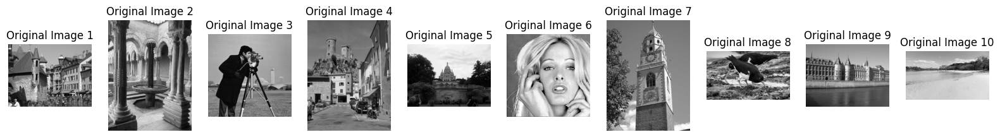

In [9]:
display_images(image_list_original, 'Original Image')

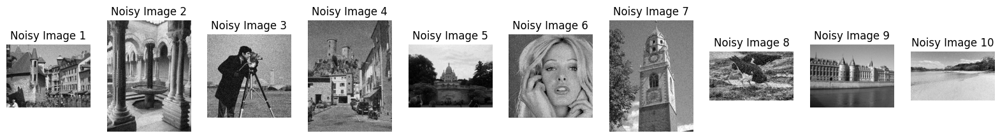

In [10]:
display_images(image_list_noisy, 'Noisy Image')

In [11]:
import matplotlib.pyplot as plt
%matplotlib notebook

"""This function is used to select a region of interest (ROI) in an image. The ROI is selected by clicking
two points on the image: the top left corner and the bottom right corner of the ROI """

def select_roi(image_path):
    roi = []
    
    def on_click(event):
        nonlocal roi
        if event.button == 1 and event.inaxes == ax:
            roi.append((int(event.xdata), int(event.ydata)))
            if len(roi) == 1:
                ax.plot(event.xdata, event.ydata, 'ro')
                fig.canvas.draw()
            elif len(roi) == 2:
                ax.plot(event.xdata, event.ydata, 'ro')
                ax.add_patch(plt.Rectangle(roi[0], roi[1][0] - roi[0][0], roi[1][1] - roi[0][1], linewidth=1, edgecolor='r', facecolor='none'))
                fig.canvas.draw()
                plt.close()

    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    fig, ax = plt.subplots()
    ax.imshow(image, cmap='gray')
    fig.canvas.mpl_connect('button_press_event', on_click)  
    plt.show()
    return roi

<IPython.core.display.Javascript object>


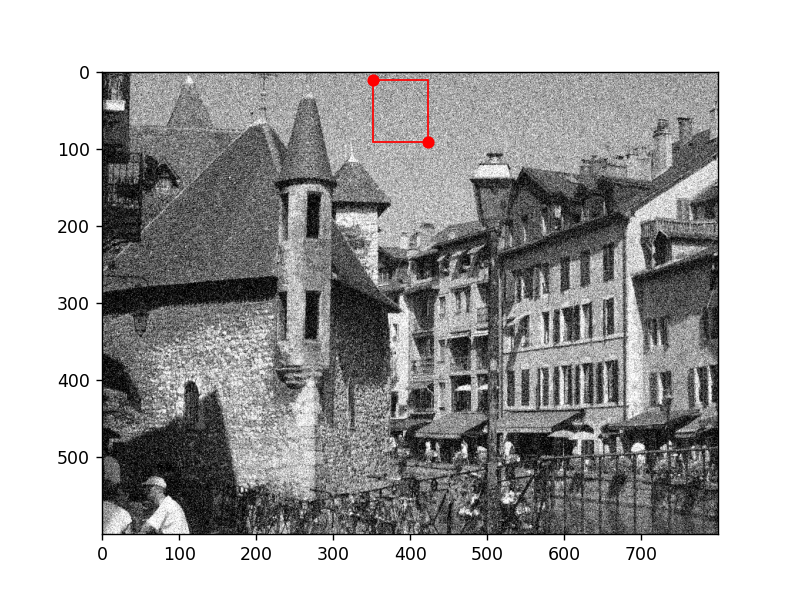

Selected ROI: []


In [12]:
roi_0 = select_roi(image_list_noisy[0])
print("Selected ROI:", roi_0)

In [29]:
roi_0

[(352, 10), (423, 90)]

<IPython.core.display.Javascript object>


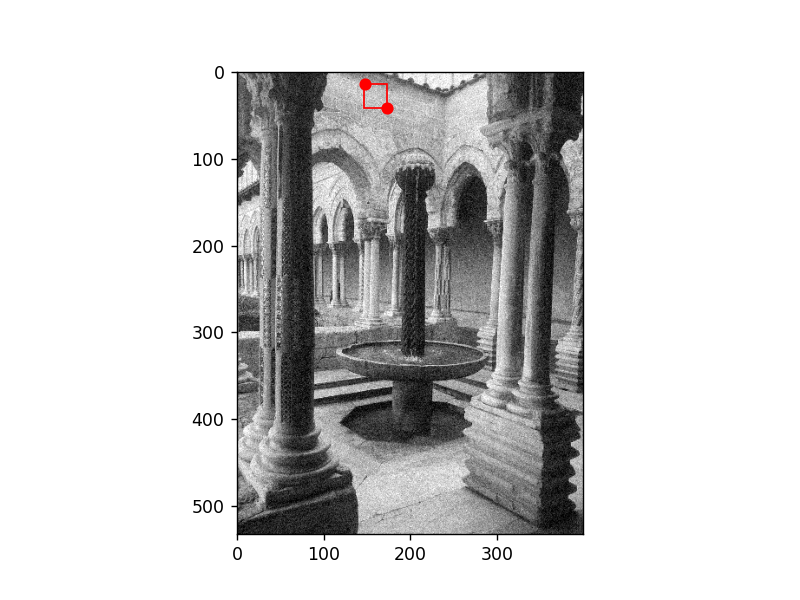

Selected ROI: []


In [14]:
roi_1 = select_roi(image_list_noisy[1])
print("Selected ROI:", roi_1)

In [30]:
roi_1

[(147, 13), (173, 41)]

<IPython.core.display.Javascript object>


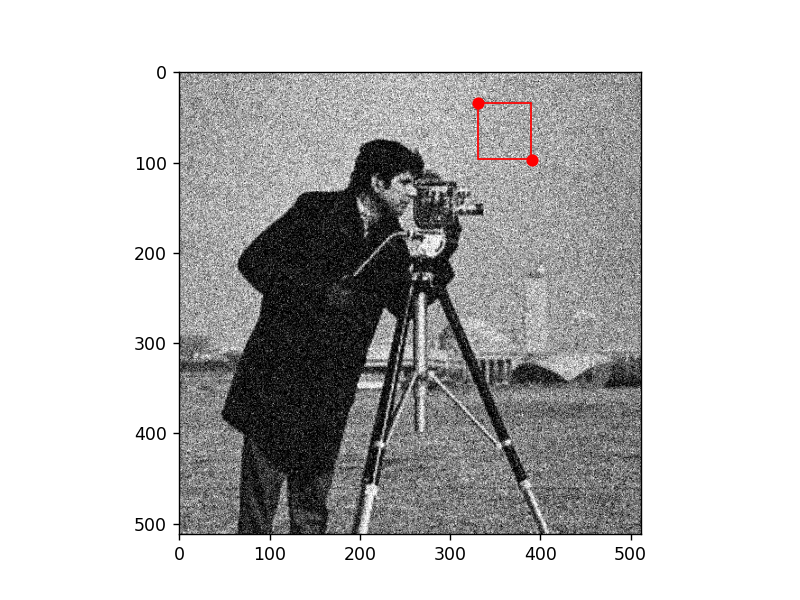

Selected ROI: []


In [16]:
roi_2 = select_roi(image_list_noisy[2])
print("Selected ROI:", roi_2)

<IPython.core.display.Javascript object>


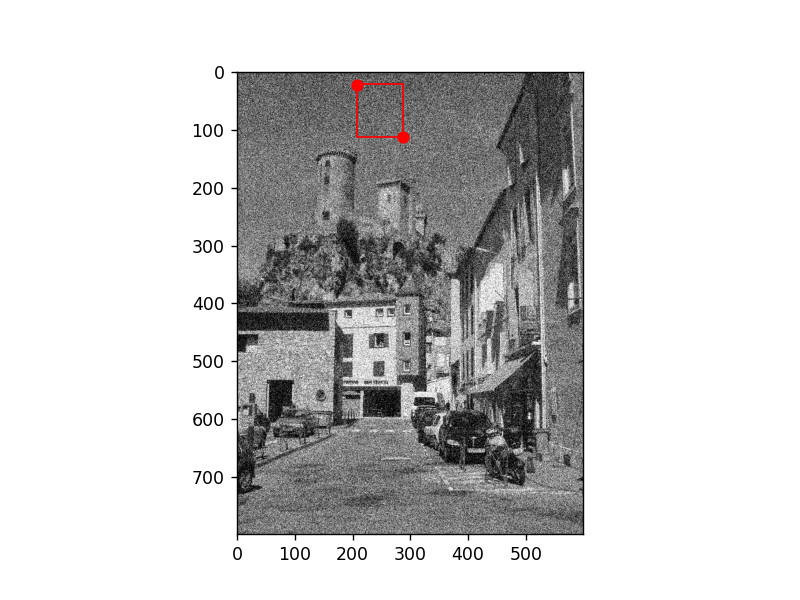

Selected ROI: []


In [17]:
roi_3 = select_roi(image_list_noisy[3])
print("Selected ROI:", roi_3)

<IPython.core.display.Javascript object>


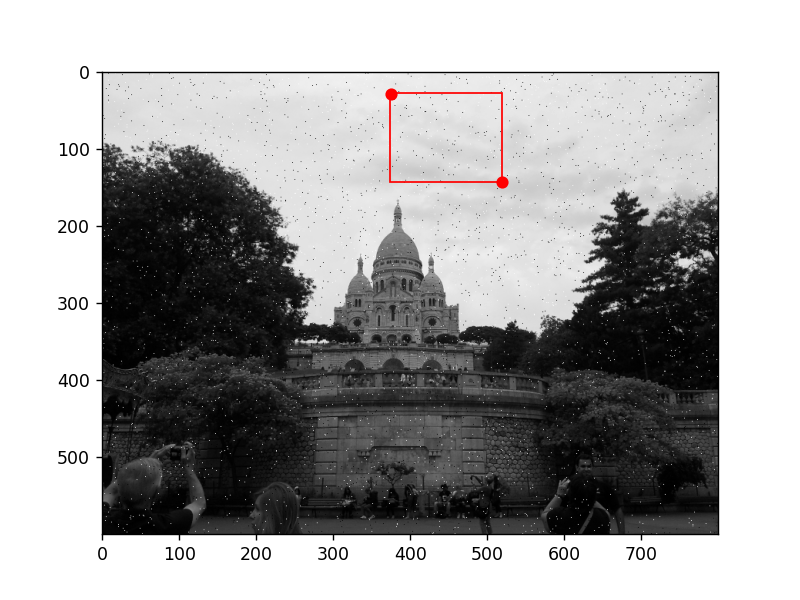

Selected ROI: []


In [18]:
roi_4 = select_roi(image_list_noisy[4])
print("Selected ROI:", roi_4)

<IPython.core.display.Javascript object>


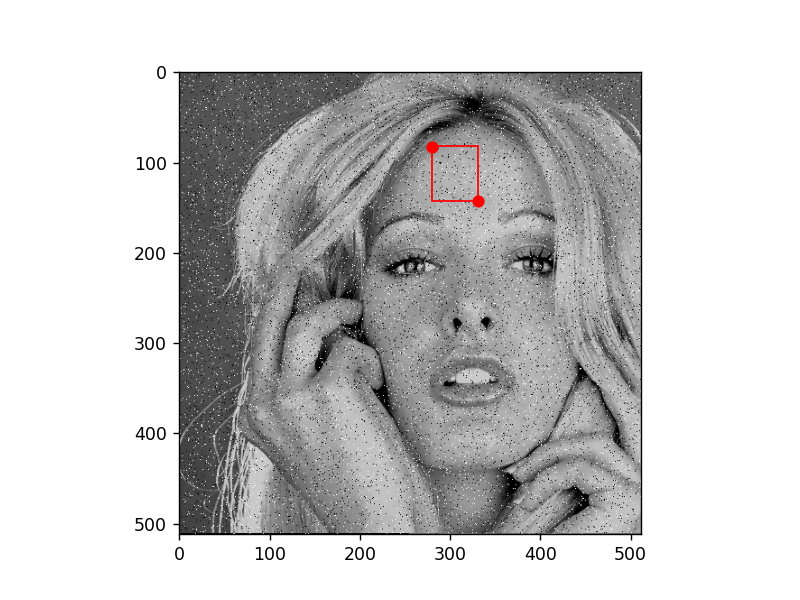

Selected ROI: []


In [19]:
roi_5 = select_roi(image_list_noisy[5])
print("Selected ROI:", roi_5)

<IPython.core.display.Javascript object>


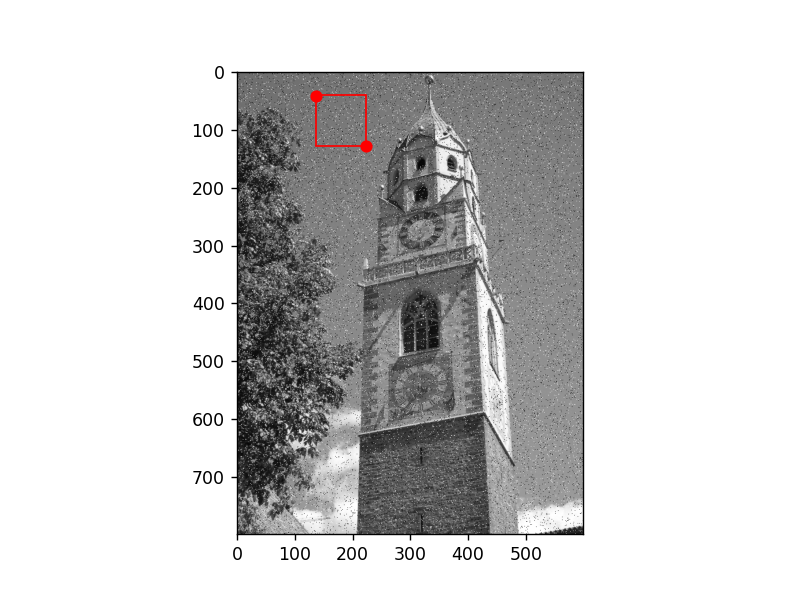

Selected ROI: []


In [31]:
roi_6 = select_roi(image_list_noisy[6])
print("Selected ROI:", roi_6)

<IPython.core.display.Javascript object>


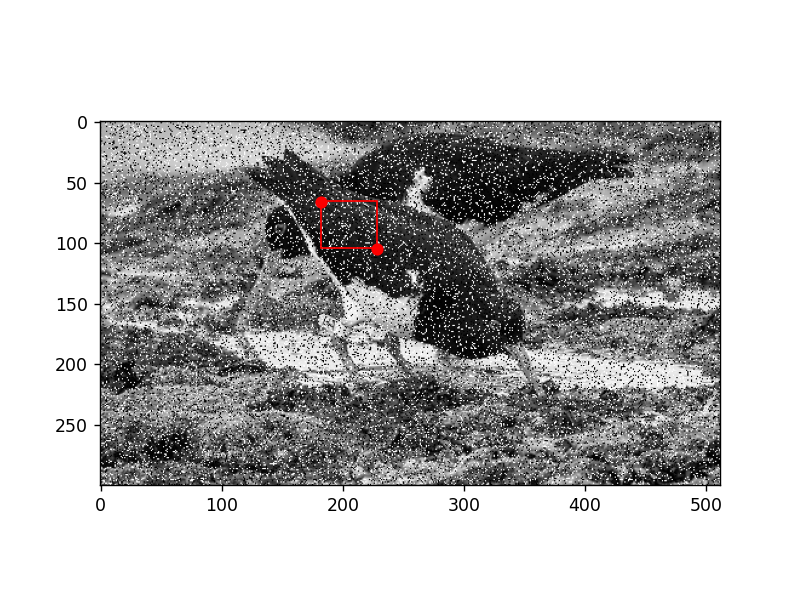

Selected ROI: []


In [32]:
roi_7 = select_roi(image_list_noisy[7])
print("Selected ROI:", roi_7)

<IPython.core.display.Javascript object>


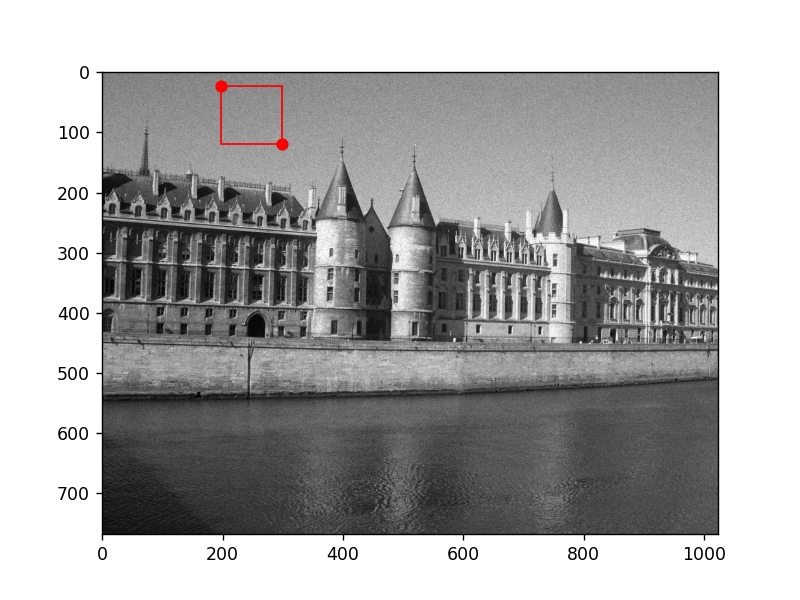

Selected ROI: []


In [33]:
roi_8 = select_roi(image_list_noisy[8])
print("Selected ROI:", roi_8)

<IPython.core.display.Javascript object>


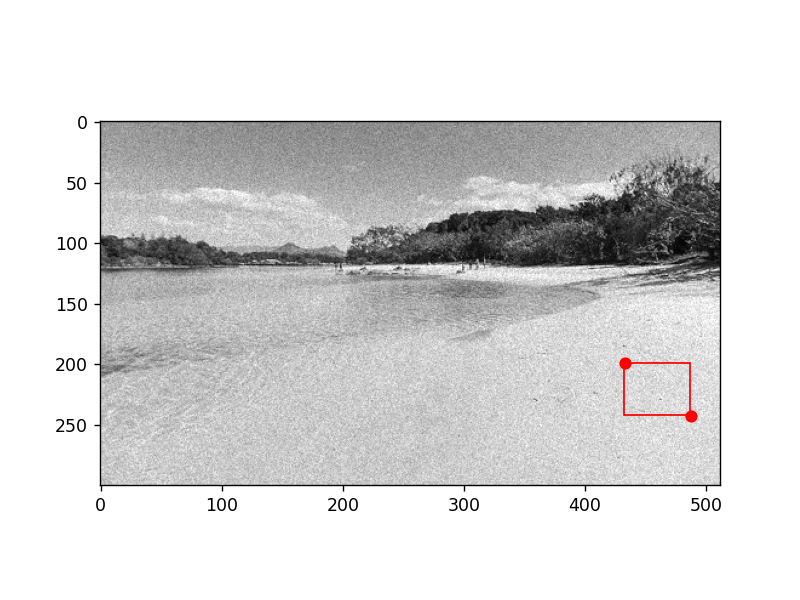

Selected ROI: []


In [34]:
roi_9 = select_roi(image_list_noisy[9])
print("Selected ROI:", roi_9)

In [35]:
# Here we list all the roi, since we are looking for uniform zones within the image
roi_list = []

for i in range(10):
    roi_variable_name = f"roi_{i}"
    roi_value = eval(roi_variable_name)
    roi_list.append(roi_value)

In [36]:
roi_list

[[(352, 10), (423, 90)],
 [(147, 13), (173, 41)],
 [(331, 34), (390, 96)],
 [(208, 21), (288, 112)],
 [(374, 27), (519, 143)],
 [(280, 82), (331, 142)],
 [(136, 40), (223, 127)],
 [(182, 65), (228, 104)],
 [(197, 23), (299, 119)],
 [(432, 199), (487, 242)]]

In [37]:
# This function is used to determine the type of noise present in an image

def detect_noise_type(noisy_img, roi_noisy, mean_noise, std_noise, slope, dif_roi):
    """
    First we calculate the Laplacian of the noisy image to detect edges, 
    which correspond to rapid changes in intensity in the image. This can 
    give us an idea of the magnitude of the noise.
    """
    laplacian = cv2.Laplacian(noisy_img, cv2.CV_64F)
    noise_magnitude = np.absolute(laplacian).ravel()
    
    """
    Then we calculate the Spearman correlation between the pixel intensity 
    and the square root of the noise magnitude. This correlation can tell 
    us about the relationship between the noise and the pixel intensity.
    """
    pixel_intensity = noisy_img.ravel()
    sqrt_noise_magnitude = np.sqrt(noise_magnitude)
    correlation, _ = spearmanr(pixel_intensity, sqrt_noise_magnitude)

    hist, _ = np.histogram(roi_noisy.ravel(), bins=256)
    max_value = np.argmax(hist)
    
    """
    Then we calculate the probabilities of having a white or a black pixel 
    in the region of interest (ROI) of the noisy image
    """
    prob_white_roi = np.sum(roi_noisy == 255) / roi_noisy.size
    prob_black_roi = np.sum(roi_noisy == 0) / roi_noisy.size
    
    """
    Finally, we use these measures to infer the type of noise. The specific 
    thresholds and conditions are based on empirical knowledge about the 
    characteristics of different types of noise
    """
    if dif_roi < -0.42 and 0.13 < slope :#and 0.009 < correlation
        return "Poisson noise", prob_white_roi, prob_black_roi, correlation, dif_roi
    
    elif 0.009 < prob_white_roi and 0.009 < prob_black_roi or slope<0 and correlation<0:
        return "Salt and Pepper noise", prob_white_roi, prob_black_roi, correlation,dif_roi
    
    elif 0.01 - 0.005 <= std_noise <= 0.30 + 0.005 and  0 < max_value < 256 :
        return "Gaussian noise", prob_white_roi, prob_black_roi, correlation,dif_roi
    
    else:
        return "Unknown noise", prob_white_roi, prob_black_roi, correlation,dif_roi

In [38]:
def plot_image_and_histograms(image_list_original, image_list_noisy, roi_list):
    num_images = len(image_list_original)
    """
    We set up a grid with one row per image and three columns to display the noisy image, 
    its histogram (ROI) and a scatter plot of pixel intensity versus noise magnitude
    """
    fig, axes = plt.subplots(num_images, 3, figsize=(25, 5*num_images))
    
    image_noise_dict = {}
    
    for i, (original_img_path, noisy_img_path, roi) in enumerate(zip(image_list_original, image_list_noisy, roi_list)):      
        """
        For each image in the input lists, 
        here we read the original and noisy images and extract the region of interest (ROI) in both.
        """
        original_img = cv2.imread(original_img_path, cv2.IMREAD_GRAYSCALE)
        noisy_img = cv2.imread(noisy_img_path, cv2.IMREAD_GRAYSCALE)
        
        roi_start, roi_end = roi
        roi_original = original_img[roi_start[1]:roi_end[1], roi_start[0]:roi_end[0]]
        roi_noisy = noisy_img[roi_start[1]:roi_end[1], roi_start[0]:roi_end[0]]
        normalized_noise_img = roi_noisy / 255.0
        
        #We calculate the histogram of the noise in the ROI
        hist1, _ = np.histogram(normalized_noise_img.ravel(), bins=256)
        max_value = np.argmax(hist1)
        
        """
        We calculate various statistics, such as the mean, standard deviation and variance of the noise in the ROI. 
        """
        mean_noise = np.mean(normalized_noise_img)
        std_noise = np.std(normalized_noise_img)
        variance_noise_roi = np.round(np.var(normalized_noise_img)*100, 2)
        
        pixel_intensity_roi = normalized_noise_img.ravel()
        sqrt_roi=np.round(np.sqrt(np.mean(pixel_intensity_roi)),3)
        dif_roi = np.round(variance_noise_roi - sqrt_roi,3)
        
        #To plot the trend between the pixel intensity and the noise magnitude this time we took the 
        #whole image with noise, because if it had Poisson noise it would vary according to the intensity in the whole image.
        normalized_noise_image = noisy_img / 255.0
        variance_noise_full = np.round(np.var(noisy_img / 255.0)*100, 2)      
        pixel_intensity = normalized_noise_image.ravel()
        laplacian = cv2.Laplacian(normalized_noise_image, cv2.CV_64F)
        noise_magnitude = np.absolute(laplacian).ravel()
        
        axes[i, 2].scatter(pixel_intensity, noise_magnitude, alpha=0.1, s=5)
        
        """
        In this part of the function we plot a scatter plot of pixel intensity versus noise magnitude for each image. 
        We also fit a regression line to this scatter plot to understand the relationship between the pixel intensity 
        and the noise magnitude
        """
        n_bins = 100
        bin_edges = np.linspace(pixel_intensity.min(), pixel_intensity.max(), n_bins + 1)
        bin_max_values = [np.max(noise_magnitude[(pixel_intensity >= left_edge) & (pixel_intensity < right_edge)]) if len(noise_magnitude[(pixel_intensity >= left_edge) & (pixel_intensity < right_edge)]) > 0 else 0 for left_edge, right_edge in zip(bin_edges[:-1], bin_edges[1:])]
        reg_line_x = (bin_edges[:-1] + bin_edges[1:]) / 2
        reg_line_y = bin_max_values
        slope, intercept = np.polyfit(reg_line_x, reg_line_y, 1)
        
        #And in this part we detect the type of noise an image has
        noise_type, prob_white_roi, prob_black_roi, correlation, dif_roi = detect_noise_type(noisy_img, roi_noisy, mean_noise, std_noise, slope, dif_roi)
        
        image_noise_dict[noisy_img_path] = noise_type
        
        axes[i, 0].imshow(noisy_img, cmap='gray')
    
        rect = Rectangle(roi_start, roi_end[0]-roi_start[0], roi_end[1]-roi_start[1], 
                     linewidth=2, edgecolor='r', facecolor='none')
        axes[i, 0].add_patch(rect)
    
        axes[i, 0].set_title(f'Original Image with noise{i + 1}')
        axes[i, 0].axis('off')
    
        axes[i, 1].hist(roi_noisy.ravel(), bins=256)
        axes[i, 1].set_title('Noisy Image ROI Histogram')
        
        axes[i, 2].plot(reg_line_x, intercept + slope * reg_line_x, color='red', linewidth=2)

        axes[i, 2].set_title('Pixel Intensity vs. Noise Magnitude')
        axes[i, 2].set_xlabel('Pixel Intensity')
        axes[i, 2].set_ylabel('Noise Magnitude')

        legend_text = f'Mean: {mean_noise:.2f}\nStd ROI: {std_noise:.2f}\nMax value : {max_value}\nVar ROI % : {variance_noise_roi}\nSqrt roi %: {sqrt_roi}\nDif roi : {dif_roi}'
        axes[i, 2].legend([legend_text],loc="upper right")
        
        legend_text = f'Noise type: {noise_type}\nSlope: {slope:.2f}\nProb white roi: {prob_white_roi:.2f}\nProb black roi: {prob_black_roi:.2f}\nCorrelation pixel intensity: {correlation:.2f}' 
        axes[i, 1].legend([legend_text],loc="upper right")

    plt.tight_layout()
    plt.show()
    return image_noise_dict

<IPython.core.display.Javascript object>


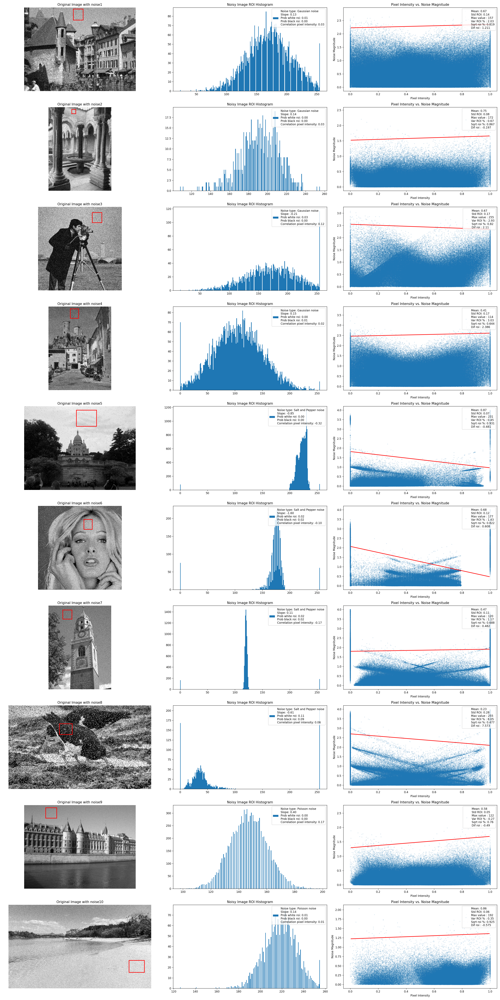

In [39]:
image_noise_dict = plot_image_and_histograms(image_list_original, image_list_noisy, roi_list)

###### task 2), you may select a spatial filtering you believe may be more appropriate or implement an adaptive filter. Please, motivate your implementation choices.

MSE and PSNR for Original Image vs Noisy Image are 100.461 and 28.111 respectively
MSE and PSNR for Noisy Image vs Denoising 1 are 97.528 and 28.24 respectively
MSE and PSNR for Noisy Image vs Denoising 2 are 100.834 and 28.095 respectively


<IPython.core.display.Javascript object>


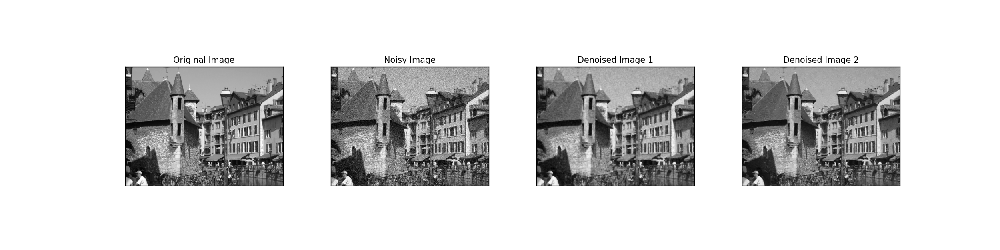

MSE and PSNR for Original Image vs Noisy Image are 84.388 and 28.868 respectively
MSE and PSNR for Noisy Image vs Denoising 1 are 87.511 and 28.71 respectively
MSE and PSNR for Noisy Image vs Denoising 2 are 84.72 and 28.851 respectively


<IPython.core.display.Javascript object>


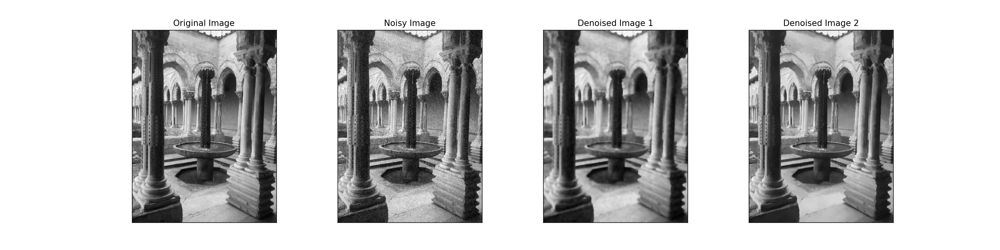

MSE and PSNR for Original Image vs Noisy Image are 103.87 and 27.966 respectively
MSE and PSNR for Noisy Image vs Denoising 1 are 99.431 and 28.156 respectively
MSE and PSNR for Noisy Image vs Denoising 2 are 100.879 and 28.093 respectively


<IPython.core.display.Javascript object>


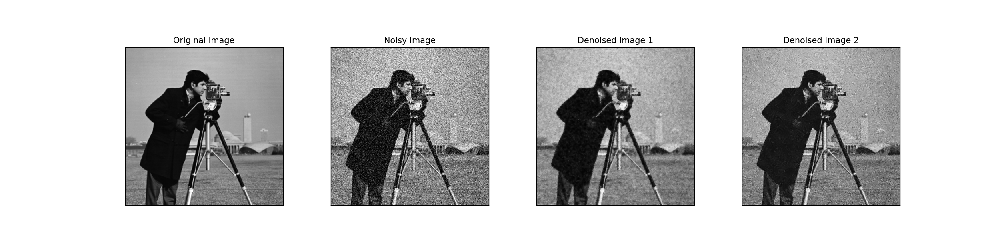

MSE and PSNR for Original Image vs Noisy Image are 103.277 and 27.991 respectively
MSE and PSNR for Noisy Image vs Denoising 1 are 99.573 and 28.149 respectively
MSE and PSNR for Noisy Image vs Denoising 2 are 102.913 and 28.006 respectively


<IPython.core.display.Javascript object>


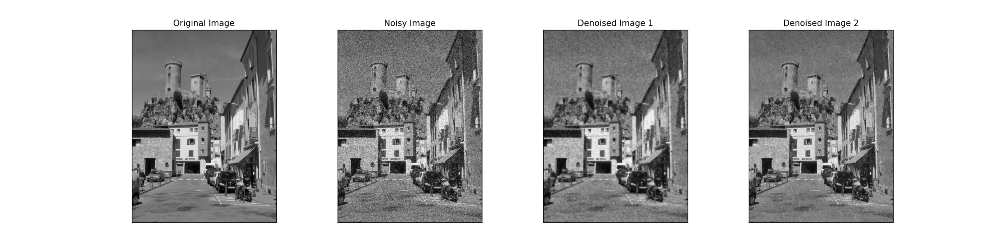

MSE and PSNR for Original Image vs Noisy Image are 1.052 and 47.912 respectively
MSE and PSNR for Noisy Image vs Denoising 1 are 22.167 and 34.674 respectively
MSE and PSNR for Noisy Image vs Denoising 2 are 28.838 and 33.531 respectively


<IPython.core.display.Javascript object>


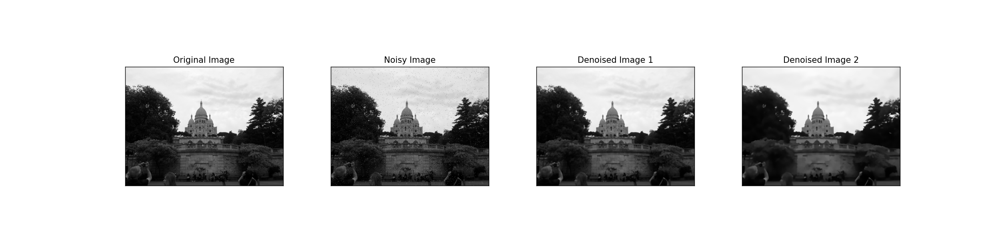

MSE and PSNR for Original Image vs Noisy Image are 5.391 and 40.814 respectively
MSE and PSNR for Noisy Image vs Denoising 1 are 33.509 and 32.879 respectively
MSE and PSNR for Noisy Image vs Denoising 2 are 39.645 and 32.149 respectively


<IPython.core.display.Javascript object>


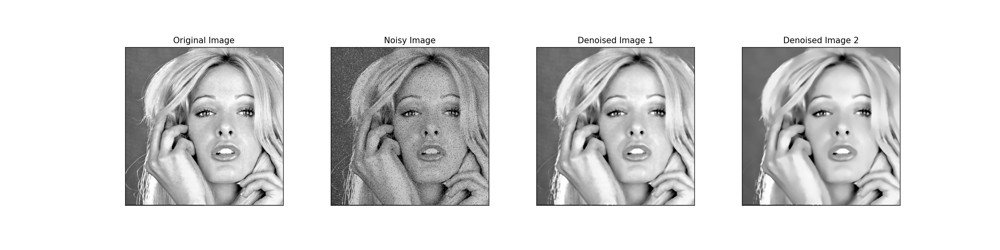

MSE and PSNR for Original Image vs Noisy Image are 4.479 and 41.619 respectively
MSE and PSNR for Noisy Image vs Denoising 1 are 35.494 and 32.629 respectively
MSE and PSNR for Noisy Image vs Denoising 2 are 41.041 and 31.999 respectively


<IPython.core.display.Javascript object>


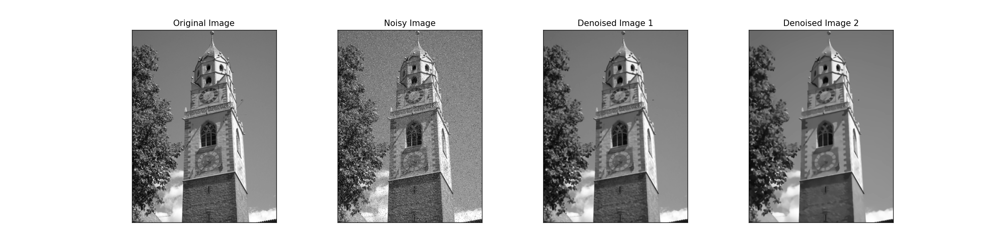

MSE and PSNR for Original Image vs Noisy Image are 21.549 and 34.797 respectively
MSE and PSNR for Noisy Image vs Denoising 1 are 66.632 and 29.894 respectively
MSE and PSNR for Noisy Image vs Denoising 2 are 72.467 and 29.529 respectively


<IPython.core.display.Javascript object>


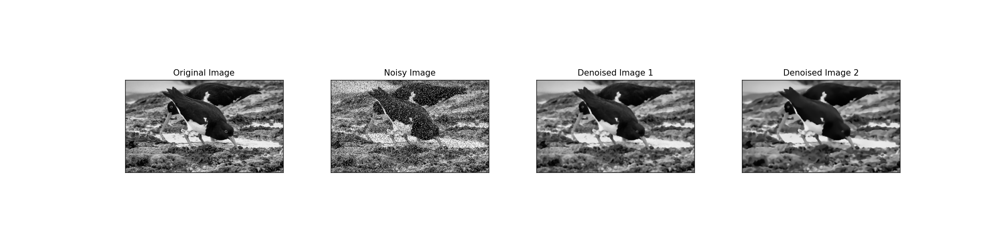

MSE and PSNR for Original Image vs Noisy Image are 60.425 and 30.319 respectively
MSE and PSNR for Noisy Image vs Denoising 1 are 70.828 and 29.629 respectively
MSE and PSNR for Noisy Image vs Denoising 2 are 90.921 and 28.544 respectively


<IPython.core.display.Javascript object>


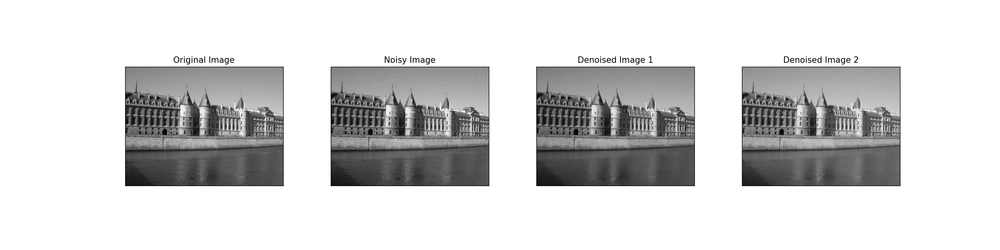

MSE and PSNR for Original Image vs Noisy Image are 71.071 and 29.614 respectively
MSE and PSNR for Noisy Image vs Denoising 1 are 76.057 and 29.319 respectively
MSE and PSNR for Noisy Image vs Denoising 2 are 88.608 and 28.656 respectively


<IPython.core.display.Javascript object>


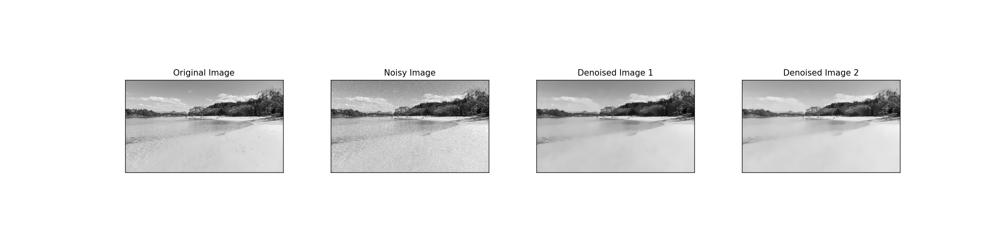

In [40]:
def process_images(image_noise_dict,image_list_noisy,image_list_original):
    #The code creates a dictionary (image_original_dict) that relates noisy images to their corresponding original images.
    #It iterates over the list of noisy images and searches for a match in the list of original images using the base name 
    #of each image and also created a dictionary that relates all the MSE and PSNR for each noisy images. 
    image_original_dict = {}
    mse_psnr_dict = {}
    for noisy_img_path in image_list_noisy:
        base_name = os.path.splitext(os.path.basename(noisy_img_path))[0][1:]
        original_img_path = ""
        for original_img_path in image_list_original:
            if base_name in original_img_path:
                image_original_dict[noisy_img_path] = original_img_path
                break
    #The path to the corresponding original image is looked up using the image_original_dict dictionary.
    for image_path, noise_type in image_noise_dict.items():
        original_img_path = image_original_dict.get(image_path)
        if original_img_path is None:
            print(f"Failed to find original image for {image_path}")
            continue
        
        original_img = cv2.imread(original_img_path, cv2.IMREAD_GRAYSCALE)
        noisy_img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

        denoised_img1 = None
        denoised_img2 = None
        
        def calculate_mse(image1, image2):
            return mean_squared_error(image1, image2)

        def calculate_psnr(image1, image2):
            mse = calculate_mse(image1, image2)
            if mse == 0: 
                return 100
            max_pixel = 255.0
            psnr = 20 * math.log10(max_pixel / math.sqrt(mse))
            return psnr

        if noise_type == 'Gaussian noise':
            #First denoising gaussian Method: Bilateral Filter
            img_bilateral = cv2.bilateralFilter(noisy_img, 9, 75, 75)

            f = np.fft.fft2(noisy_img)
            fshift = np.fft.fftshift(f)
            rows, cols = noisy_img.shape
            crow, ccol = int(rows / 2), int(cols / 2)
            #Butterworth Filter
            D0 = 150  
            n = 2  
            u = np.array([np.power((i - crow), 2) for i in range(rows)])
            v = np.array([np.power((j - ccol), 2) for j in range(cols)])
            idx = np.sqrt(u[:, None] + v)
            mask = 1 / (1 + np.power(idx / D0, 2 * n))

            fshift_masked = fshift * mask

            # Inverse shift and inverse transform to get the image back
            f_ishift = np.fft.ifftshift(fshift_masked)
            img_back = np.fft.ifft2(f_ishift)
            img_back = np.abs(img_back)

            img_back_norm = cv2.normalize(img_back, None, 0, 255, cv2.NORM_MINMAX)
            img_back_uint8 = cv2.convertScaleAbs(img_back_norm)

            #Second denoising gaussian method: FFT + NLM
            NLM_img = cv2.fastNlMeansDenoising(img_back_uint8, None, 10, 7, 21)
            
            denoised_img1 = img_bilateral
            denoised_img2 = NLM_img
            
        elif noise_type == 'Salt and Pepper noise':
            #First denoising Salt and Pepper Method: Median filter 
            median_img = cv2.medianBlur(noisy_img, 5)#window=3 could also work for the first three images

            #Second denoising Salt and Pepper Method: Median + Non-local Means
            NLM_img_me = cv2.fastNlMeansDenoising(median_img, None, 10, 7, 21)
            
            denoised_img1 = median_img
            denoised_img2 = NLM_img_me

        elif noise_type == 'Poisson noise':
            #First denoising Poisson Method: Anscombe + wavelet + Inverted Anscombe + NLM
            origi_img_p = img_as_float(original_img)
            noisy_img_p = img_as_float(noisy_img)

            def normalize(image):
                return (image - np.min(image)) / (np.max(image) - np.min(image))
            #Anscombe
            noisy_anscombe = 2.0 * np.sqrt(noisy_img_p  + 3.0 / 8.0)

            noisy_anscombe_normalized = normalize(noisy_anscombe)
            noisy_anscombe_8bit = img_as_ubyte(noisy_anscombe_normalized)
            NLM_asc = cv2.fastNlMeansDenoising(noisy_anscombe_8bit, None, 10, 7, 21)

            #wavelet
            denoised = denoise_wavelet(noisy_anscombe, method='BayesShrink', mode='soft', 
                                       rescale_sigma=True)

            denoised_norm = normalize(denoised)
            denoised_8bit = img_as_ubyte(denoised_norm )
            #Second denoising Poisson Method: Anscombe + Wavelet + NLM
            NLM_wav = cv2.fastNlMeansDenoising(denoised_8bit, None, 10, 7, 21)

            #Inverted filtro anscombe
            denoised_anscombe = (denoised / 2.0)**2 - 3.0 / 8.0
            denoised_anscombe_norm = normalize(denoised_anscombe)
            denoised_anscombe_8bit = img_as_ubyte(denoised_anscombe_norm)
            #NLM
            NLM_wasc = cv2.fastNlMeansDenoising(denoised_anscombe_8bit, None, 10, 7, 21)
            
            denoised_img1 = NLM_wasc #Anscombe + Wavelet + Inver Anscombe + NLM
            denoised_img2 = NLM_wav #Anscombe + Wavelet + NLM

        # Calculates MSE y PSNR for image original with noisy image
        mse = calculate_mse(original_img, noisy_img)
        psnr = calculate_psnr(original_img, noisy_img)
        print(f"MSE and PSNR for Original Image vs Noisy Image are {np.round(mse,3)} and {np.round(psnr,3)} respectively")
        mse_psnr_dict[f'{image_path}_original_vs_noisy'] = {'mse': mse, 'psnr': psnr}
        # Calculates MSE y PSNR for noisy image with first denoising image
        if denoised_img1 is not None:
            mse_1 = calculate_mse(noisy_img, denoised_img1)
            psnr_1 = calculate_psnr(noisy_img, denoised_img1)
            print(f"MSE and PSNR for Noisy Image vs Denoising 1 are {np.round(mse_1,3)} and {np.round(psnr_1,3)} respectively")
            mse_psnr_dict[f'{image_path}_noisy_vs_denoised1'] = {'mse': mse_1, 'psnr': psnr_1}
        # Calculates MSE y PSNR for noisy image with second denoising image
        if denoised_img2 is not None:
            mse_2 = calculate_mse(noisy_img, denoised_img2)
            psnr_2 = calculate_psnr(noisy_img, denoised_img2)
            print(f"MSE and PSNR for Noisy Image vs Denoising 2 are {np.round(mse_2,3)} and {np.round(psnr_2,3)} respectively")
            mse_psnr_dict[f'{image_path}_noisy_vs_denoised2'] = {'mse': mse_2, 'psnr': psnr_2}
        fig, axes = plt.subplots(1, 4, figsize=(20, 5)) 

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title('Original Image')
        axes[0].set_xticks([])
        axes[0].set_yticks([])

        axes[1].imshow(noisy_img, cmap='gray')
        axes[1].set_title('Noisy Image')
        axes[1].set_xticks([])
        axes[1].set_yticks([])

        axes[2].imshow(denoised_img1, cmap='gray')
        axes[2].set_title('Denoised Image 1')
        axes[2].set_xticks([])
        axes[2].set_yticks([])
        
        axes[3].imshow(denoised_img2, cmap='gray')
        axes[3].set_title('Denoised Image 2')
        axes[3].set_xticks([])
        axes[3].set_yticks([])

        plt.subplots_adjust(wspace=0.3, hspace=0.5)
        plt.show()
    return mse_psnr_dict

mse_psnr_results = process_images(image_noise_dict,image_list_noisy,image_list_original)

In [41]:
import pickle

with open('mse_psnr_results.pickle', 'wb') as handle:
    pickle.dump(mse_psnr_results, handle, protocol=pickle.HIGHEST_PROTOCOL)

###### task 3), you will adapt the iterated conditional modes (ICM) algorithm to train a MRF and recover the denoised grayscale image.

In this part Ale and Chiara worked on the MRF algorithm.
- we can implement MRF algorithm through ICM(iterated conditional modes) in this way :

- we instatiate a matrix that will contains MSE and PSNR values of images

- for each images we computed data and penalty  errors( just 4 neighboor) associated to grey levels and to denoised images;
  in particular grey levels helps us to evaluate the minimum level of energy for each pixel  comparing errors,
  and changing pixel's value only if energy decrease after the replacement

In [42]:
import cv2
import numpy as np
import os 
import pickle
from tqdm import tqdm

def mse(imageA, imageB):
    err = np.sum((imageA.astype("float") - imageB.astype("float")) ** 2)
    err /= float(imageA.shape[0] * imageA.shape[1])
    return err

def MRF(alfa, beta, exp, max_it, image_list_noisy, image_list_original):
    
    if not os.path.exists('Denoised'):
        os.makedirs('Denoised')
    
    elements = len(image_list_noisy)
    print(f"Number of images: {elements}")
    rows = 2 * (elements + 2)
    print(f"Rows in Mse_Psnr: {rows}")

    Mse_Psnr = np.zeros((rows, max_it), dtype='float32')

    index_el = 0
    
    for i in tqdm(range(elements)):
        # Read original and noisy images
        original = cv2.imread(image_list_original[i], 0).astype('float')
        noised = cv2.imread(image_list_noisy[i], 0).astype('float')

        # Padding
        noised = cv2.copyMakeBorder(noised.copy(), 1, 1, 1, 1, cv2.BORDER_REFLECT).astype('float')
        w, h = noised.shape

        # Initialize matrices
        grey = np.ones((w - 1, h - 1, 256)).astype('float')
        denoised = noised.copy()
        E_dg = E_pg = E_dn = E_pn = np.zeros((w, h)).astype('float')

        for it in range(max_it):
            for gr_lvl in range(256):
                # Compute energies
                E_dg = alfa * np.sum((noised.astype('float') - denoised.astype('float')) ** 2)
                E_pg = beta * (np.abs(np.abs(gr_lvl - denoised[0:w - 2, 1:h - 1]) ** exp) +
                               np.abs(np.abs(gr_lvl - denoised[2:w, 1:h - 1]) ** exp) +
                               np.abs(np.abs(gr_lvl - denoised[1:w - 1, 0:h - 2]) ** exp) +
                               np.abs(np.abs(gr_lvl - denoised[1:w - 1, 2:h]) ** exp))

                grey[1:w, 1:h, gr_lvl] = E_dg + E_pg

            min_energy = np.min(grey[1:w, 1:h], axis=2)
            grey_lvl = np.argmin(grey[1:w, 1:h], axis=2).astype('float')

            E_dn = alfa * np.sum((noised.astype('float') - denoised.astype('float')) ** 2)

            E_pn = beta * (np.abs((denoised[1:w - 1, 1:h - 1] - denoised[0:w - 2, 1:h - 1]) ** 1 / 2) +
                           np.abs((denoised[1:w - 1, 1:h - 1] - denoised[2:w, 1:h - 1]) ** 1 / 2) +
                           np.abs((denoised[1:w - 1, 1:h - 1] - denoised[1:w - 1, 0:h - 2]) ** 1 / 2) +
                           np.abs((denoised[1:w - 1, 1:h - 1] - denoised[1:w - 1, 2:h]) ** 1 / 2))
            
            E_denoised = E_dn + E_pn    

            # now we have to change pixels in which energy decrease substituting with the level of gray previously calculated
            if np.any(min_energy < E_denoised):
                denoised[1:w-1, 1:h-1][min_energy < E_denoised] = grey_lvl[min_energy < E_denoised]
                                
            # for each results we are saving them  in Denoised Directory  
            path = os.path.join('./Denoised', f"denoised_{i}.jpg")
            cv2.imwrite(path, denoised)
                
            # computing MSE and PSNR 
            Mse_Psnr[index_el, it] = mse(noised, denoised)
            Mse_Psnr[index_el + 1, it] = cv2.PSNR(denoised, noised)
            
        index_el += 2
        print(f"Current index_el: {index_el}")
        
    with open('Mse_Psnr.pickle', 'wb') as m:
        pickle.dump(Mse_Psnr, m)

Now we can execute Markov Random Fields algorithm on dataset  in order to denoise  images and to 
evaluate the results through mse and psnr;
alfa=2(to emphasize Data term)
beta=1
exp=0.5
max_it=10

In [43]:
MRF(2, 1, 0.5, 10, image_list_noisy, image_list_original)

Number of images: 10
Rows in Mse_Psnr: 24


 10%|████████▏                                                                         | 1/10 [01:53<17:03, 113.77s/it]

Current index_el: 2


 20%|████████████████▌                                                                  | 2/10 [02:44<10:14, 76.84s/it]

Current index_el: 4


 30%|████████████████████████▉                                                          | 3/10 [03:45<08:07, 69.64s/it]

Current index_el: 6


 40%|█████████████████████████████████▏                                                 | 4/10 [05:36<08:34, 85.79s/it]

Current index_el: 8


 50%|█████████████████████████████████████████▌                                         | 5/10 [07:28<07:56, 95.26s/it]

Current index_el: 10


 60%|█████████████████████████████████████████████████▊                                 | 6/10 [08:29<05:34, 83.57s/it]

Current index_el: 12


 70%|██████████████████████████████████████████████████████████                         | 7/10 [10:16<04:33, 91.28s/it]

Current index_el: 14


 80%|██████████████████████████████████████████████████████████████████▍                | 8/10 [10:53<02:27, 73.89s/it]

Current index_el: 16


 90%|█████████████████████████████████████████████████████████████████████████▊        | 9/10 [13:50<01:46, 106.28s/it]

Current index_el: 18


100%|██████████████████████████████████████████████████████████████████████████████████| 10/10 [14:27<00:00, 86.74s/it]

Current index_el: 20


then we can compute a dataframe with all data gathered

In [44]:
import pandas as pd
import pickle

with open('Mse_Psnr.pickle', 'rb') as f:
       
        Mse_Psnr= pickle.load(f)

DF=pd.DataFrame([Mse_Psnr[0,:],Mse_Psnr[1,:],Mse_Psnr[2,:],Mse_Psnr[3,:],Mse_Psnr[4,:],Mse_Psnr[5,:],Mse_Psnr[6,:],Mse_Psnr[7,:],Mse_Psnr[8,:],Mse_Psnr[9,:],
                Mse_Psnr[10,:],Mse_Psnr[11,:],Mse_Psnr[12,:],Mse_Psnr[13,:],Mse_Psnr[14,:],Mse_Psnr[15,:],Mse_Psnr[16,:],Mse_Psnr[17,:],Mse_Psnr[18,:],Mse_Psnr[19,:]]
                ,index=["89.bmp MSE","89.bmp PSNR","47.bmp MSE","47.bmp PSNR","20.bmp MSE","20.bmp PSNR"
                                                 ,"4.bmp MSE ","4.bmp PSNR","36.bmp MSE","36.bmp PSNR","105.bmp MSE","105.bmp PSNR",
                                                 "73.bmp MSE","73.bmp PSNR","91.bmp MSE","91.bmp PSNR","63.bmp MSE","63.bmp PSNR"
                                                 ,"42.bmp MSE","42.bmp PSNR"]
                ,columns=["it1","it2","it3","it4","it5","it6","it7","it8","it9","it10"])

display(DF)

,it1,it2,it3,it4,it5,it6,it7,it8,it9,it10
89.bmp MSE,2066.738037,1130.007446,2037.722534,1289.660522,2049.186523,1355.724731,2062.373535,1390.612793,2072.225342,1412.901489
89.bmp PSNR,14.977949,17.599991,15.039353,17.026051,15.014989,16.809088,14.987130,16.698742,14.966434,16.629684
47.bmp MSE,671.322998,399.721985,685.316467,465.288544,701.401184,494.303741,712.197205,509.011200,717.873535,516.202332
47.bmp PSNR,19.861488,22.113224,19.771893,21.453581,19.671139,21.190865,19.604801,21.063530,19.570324,21.002604
20.bmp MSE,2649.201172,1413.159302,2541.096680,1604.000488,2536.732422,1697.576904,2558.177002,1769.290039,2596.470215,1836.631836
20.bmp PSNR,13.899654,16.628893,14.080591,16.078758,14.088058,15.832509,14.051497,15.652813,13.986970,15.490582
4.bmp MSE,2939.571289,1537.885010,2815.682129,1713.770142,2800.138672,1785.970825,2798.878906,1819.899414,2801.571045,1841.033691
4.bmp PSNR,13.447964,16.261564,13.634967,15.791278,13.659008,15.612061,13.660963,15.530330,13.656787,15.480186
36.bmp MSE,339.736481,339.862762,382.760193,378.425201,407.173553,398.970367,423.109802,411.460541,432.037201,419.261627
36.bmp PSNR,22.819382,22.817768,22.301537,22.351004,22.033009,22.121397,21.866272,21.987522,21.775593,21.905952


Finally we can show the results of MRF applied to our dataset ,in particular for each images  we showed images  as follow:

Noisy , second iteration of MRF , last iteration of MRF , Original

As we can see on dataframe showed before , we obtained best results of MRF(i.e. lower MSE and  Higher PSNR)yet  on second iteration 
indeed it is very noticeable (especially in images with salt and pepper noise) the decreasing of the noise , preserving edges